<a href="https://colab.research.google.com/github/sumayyahc1/cat-classifier/blob/main/Cat_Breed_Classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# All imports
import os
from pathlib import Path

! [ -e /content ] && pip install -Uqq fastbook
import fastbook
fastbook.setup_book()
from fastbook import *
from fastai.vision.widgets import *

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 36.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.3/519.3 kB 36.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 56.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 16.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 21.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 29.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 77.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 66.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 75.2 MB/s eta 0:00:00
Mounted at /content/gdrive


# Get Training Data

In [ ]:
api_key = 'a4ea0277f8f44f32afb1da60e3910dd4'
def bing_image_get(search_query, destination):
  # configure url request
  endpoint = "https://api.bing.microsoft.com/"
  url = f"{endpoint}v7.0/images/search"
  headers = { "Ocp-Apim-Subscription-Key": api_key }
  params = {
      "q": search_query,
      "license": "public",
      "imageType": "photo",
      "safeSearch": "Strict",
  }
  new_offset = 0
  # page through 150 results
  contentUrls = []
  while new_offset <= 150:
      print(new_offset)
      params["offset"] = new_offset

      response = requests.get(url, headers=headers, params=params)
      response.raise_for_status()
      result = response.json()

      time.sleep(1)

      new_offset = result["nextOffset"]
      for item in result["value"]:
          contentUrls.append(item["contentUrl"])

  # save images
  if not os.path.exists(destination):
      os.makedirs(destination)
  for url in contentUrls:
    # clean image urls
    split = url.split("/")
    last_item = split[-1]
    second_split = last_item.split("?")
    if len(second_split) > 1:
        last_item = second_split[0]
    third_split = last_item.split("!")
    if len(third_split) > 1:
        last_item = third_split[0]

    print(last_item)
    path = os.path.join(destination, last_item)
    # save to destination directory
    try:
        with open(path, "wb") as f:
            image_data = requests.get(url)
            f.write(image_data.content)
    except OSError:
        pass

In [ ]:
bing_image_get('persian cat', './images/persian')

0
56
93
131
white-blue-eyes-beautiful-fur-cat-wallpaper.jpg
cat-white-cat-german-longhair-cat-wallpaper.jpg
pexels-photo-3423805.jpeg
pexels-photo-2569498.jpeg
2018-11-21-13-35-39.jpg
persian-cat-2461526_640.jpg
kitten-2687003_960_720.jpg
pexels-photo-772373.jpeg
closeup-face-persian-cat.jpg
cat-623505_960_720.jpg
cat_portrait_cat_face_pet_face_cat_close_view_adidas-843475.jpg
closeup-face-of-persian-cat.jpg
cat-fluffy-walk-wallpaper-preview.jpg
pexels-photo-628672.jpeg
2018-11-27-14-37-46.jpg
cat-persian-breed-black-grey-pets-wallpaper-thumb.jpg
pexels-photo-1436008.jpeg
pexels-photo-736535.jpeg
cat-persian-breed-black-grey-pets-wallpaper-thumb.jpg
british-shorthair-cat-grey-cute-pet-wallpaper.jpg
220_F_13257640_d948cPSoWqDa2RhiS47DLupsto43poxI.jpg
pexels-photo-213120.jpeg
animals-cat-wallpaper-preview.jpg
cat-blue-eyes-animal-eyes-preview.jpg
cat-2301317_640.jpg
pexels-photo-2612982.jpeg
pexels-photo-86243.jpeg
pexels-photo-208967.jpeg
ben-torode-carpets-animals-cat-wallpaper-preview

In [ ]:
bing_image_get('bengal cat', './images/bengal')

0
48
83
122
bengal-2042592_960_720.jpg
kitten-1056695_960_720.jpg
pexels-photo-2195197.png
pexels-photo-2195197.png
cat-baby-1467865_640.jpg
grown-bengal-cat-wallpaper-thumb.jpg
Mammals-Bengal-Cat-Animal-Kingdom-Pet-Cute-3092405.jpg
cat-1443062_640.jpg
pexels-photo-977955.jpeg
hybrid-serval-domestic-savannah-cat-wallpaper-thumb.jpg
bengal-cat-2546758__180.jpg
tomcat_cat_bengal_bengalcat-1190762.jpg
grass-wildlife-cat-mammal-fauna-whiskers-vertebrate-bengal-wild-cat-small-to-medium-sized-cats-cat-like-mammal-toyger-142244.jpg
cute-kitten-cat-mammal-whiskers-savannah-vertebrate-tabby-cat-ocelot-bengal-european-shorthair-small-to-medium-sized-cats-cat-like-mammal-domestic-short-haired-cat-american-shorthair-toyger-mysterious-eyes-750656.jpg
cat-1154623__180.jpg
bengal-2476933_640.jpg
photo-68741.jpg
cat-877110__180.jpg
animal-pet-fur-kitten-cat-mammal-fauna-close-up-whiskers-savannah-animals-vertebrate-a-young-kitten-charming-bengal-wild-cat-small-to-medium-sized-cats-cat-like-mammal-dome

In [ ]:
bing_image_get('domestic shorthair cat', './images/domestic-shorthair')

0
39
76
116
view-animal-cute-pet-fur-kitten-cat-mammal-closeup-fauna-striped-close-up-pets-cats-nose-eyes-whiskers-eye-animals-vertebrate-views-cat-eyes-cat's-eye-tabby-cat-european-shorthair-cat-person-small-to-medium-sized-cats-cat-like-mammal-domestic-short-haired-cat-pixie-bob-american-shorthair-917050.jpg
cat_pet_british_shorthair-731101.jpg
animal-pet-kitten-cat-mammal-close-up-whiskers-vertebrate-domestic-cat-tiger-cat-tabby-cat-european-shorthair-small-to-medium-sized-cats-cat-like-mammal-domestic-short-haired-cat-pixie-bob-american-shorthair-598602.jpg
sweet-cute-thinking-cat-tabby-mammal-fauna-close-up-whiskers-snout-furry-vertebrate-wicked-cuddly-mischievous-naughty-tabby-cat-european-shorthair-wild-cat-small-to-medium-sized-cats-cat-like-mammal-domestic-short-haired-cat-pixie-bob-rusty-spotted-cat-toyger-wicked-thoughts-1005708.jpg
cat-mammal-vertebrate-small-to-medium-sized-cats-felidae-whiskers-carnivore-korat-british-shorthair-chartreux-russian-blue-nebelung-burmese-dome

In [ ]:
bing_image_get('siamese cat', './images/siamese')

0
55
112
siam-2766253_1280.jpg
cat-kitten-pets-tom-cat-161005.jpeg
siam-siamese-cat-cat-domestic-cat-preview.jpg
siamese-cat-cat-kitten-siam-wallpaper.jpg
cat-mieze-siamese-cat-siamese-wallpaper.jpg
cat-mieze-kitten-siamese-cat-siam-wallpaper.jpg
cat-siamese-language-blue-eyes-fat-wallpaper.jpg
pexels-photo-957579.jpeg
kitten-cat-mieze-siam-siamese-cat-wallpaper.jpg
siamese-cat-2165380_1280.jpg
2018-11-21-13-54-12.jpg
cat-siamese-cat-cat-s-eyes-wallpaper-preview.jpg
pexels-photo-2756100.png
2017-09-26-10-12-00.jpg
siamese-cat.jpg
2017-09-26-10-11-51.jpg
pexels-photo-596590.jpeg
thai-cat-1496937_960_720.jpg
breed-cat-siamese-cat-felidae-cat-wallpaper.jpg
siamese-cat-408845_960_720.jpg
kitten-352232_960_720.jpg
chat-siamois-assis--1532717420E7p.jpg
cat-1280855_960_720.jpg
siamese-1288975_960_720.jpg
Siamese-Cats-Cat-Turquoise-Overview-2062609.jpg
pexels-photo-1311572.jpeg
le-regard-bleu-du-chat-siamois-.jpg
chat-siamois-.jpg
hair-white-animal-cute-pet-fur-portrait-fluffy-kitten-cat-mamma

In [ ]:
bing_image_get('maine coon cat', './images/maine-coon')

0
53
96
142
pexels-photo-121921.jpeg
maine-coon-cat-1478571789Cyl.jpg
cat-tabby-cute-furry-whisker-fluffy-wallpaper.jpg
maine-coon-cat-1474814654kb3.jpg
maine-coon-cat-1474554751ypD.jpg
pexels-photo-586617.jpeg
pexels-photo-1169892.jpeg
cat-feline-cat-face-cat-s-eyes-wallpaper.jpg
cat-1208013_640.jpg
cat-1215358_960_720.jpg
pexels-photo-586620.jpeg
pexels-photo-1870320.jpeg
maine-coon-2769894_1280.jpg
pexels-photo-915060.jpeg
maine-coon-cat.jpg
pexels-photo-586619.jpeg
maine-coon-cat-1460305503ph1.jpg
cat-mammal-whiskers-vertebrate-siberian-maine-coon-norwegian-forest-cat-tortoiseshell-cat-lapjeskat-small-to-medium-sized-cats-cat-like-mammal-carnivoran-domestic-short-haired-cat-domestic-long-haired-cat-574074.jpg
pexels-photo-121921.jpeg
kitten-1397071_1280.jpg
maine-coon-2164829_960_720.jpg
pexels-photo-586618.jpeg
maine-coon-cat-2052389_1280.jpg
cat-animal-pet-portrait.jpg
photo-150591.jpg
three-maine-coon-cats.jpg
maine-coon-1723958_960_720.jpg
cat-1089609_960_720.jpg
mainecoon-1746

In [ ]:
fns = utils.get_image_files('images')
failed = utils.verify_images(fns)
failed

(#0) []

In [ ]:
failed.map(Path.unlink);

In [ ]:
path = './images'
cats = DataBlock(
 blocks=(ImageBlock, CategoryBlock),
 get_items=get_image_files,
 splitter=RandomSplitter(valid_pct=0.2, seed=42),
 get_y=parent_label,
 item_tfms=Resize(128))

dls = cats.dataloaders(path)

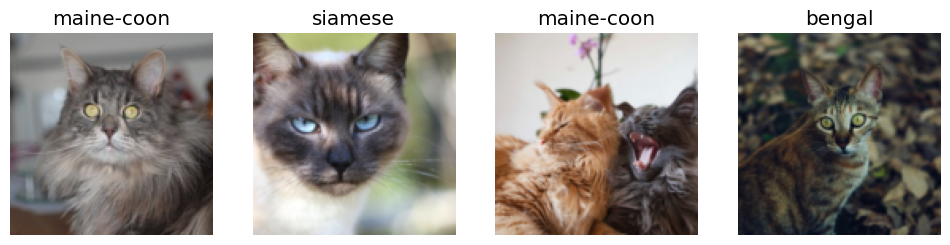

In [ ]:
dls.valid.show_batch(max_n=4, nrows=1)

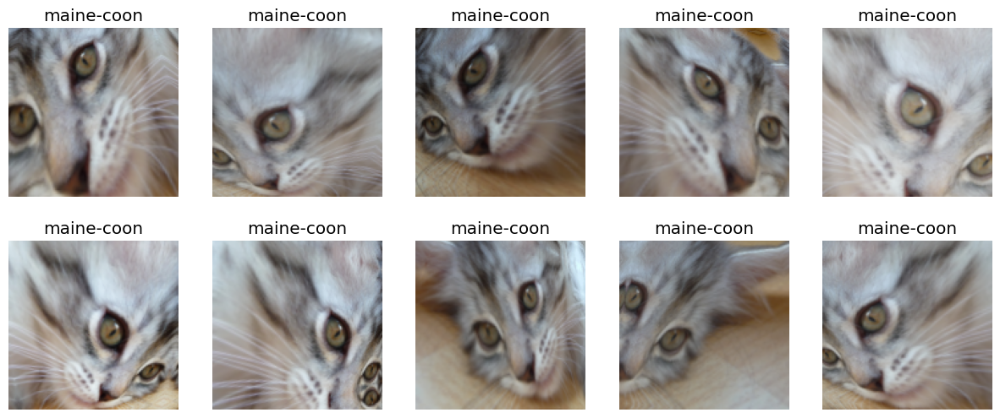

In [ ]:
cats = cats.new(item_tfms=RandomResizedCrop(128, min_scale=0.3), batch_tfms=aug_transforms(mult=2))
dls = cats.dataloaders(path)
dls.train.show_batch(max_n=10, nrows=2, unique=True)

In [ ]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

/usr/local/lib/python3.10/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd

epoch,train_loss,valid_loss,error_rate,time
0,2.754246,2.243366,0.619565,00:57


epoch,train_loss,valid_loss,error_rate,time
0,1.853537,1.726169,0.500000,01:15
1,1.717471,1.689692,0.402174,01:05
2,1.479755,1.533748,0.369565,01:05
3,1.383940,1.450256,0.369565,01:03


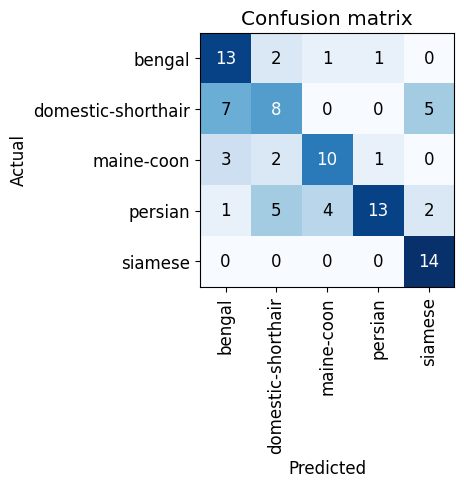

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

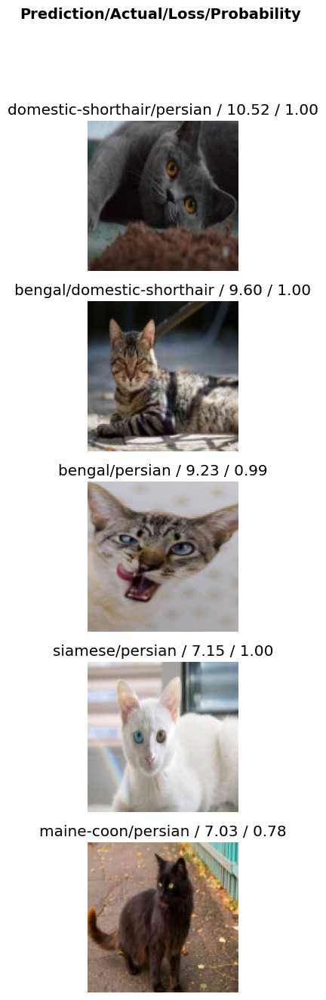

In [ ]:
# see top losses
interp.plot_top_losses(5, nrows=5)

In [ ]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [ ]:
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), f'{path}/{cat}')

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()

/usr/local/lib/python3.10/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,error_rate,time
0,2.566174,1.936311,0.554348,00:58


epoch,train_loss,valid_loss,error_rate,time
0,1.693477,1.290129,0.380435,01:02
1,1.488482,0.914644,0.282609,01:05
2,1.336592,0.825120,0.271739,01:04
3,1.170238,0.770406,0.282609,01:02
4,1.061396,0.739038,0.260870,01:04


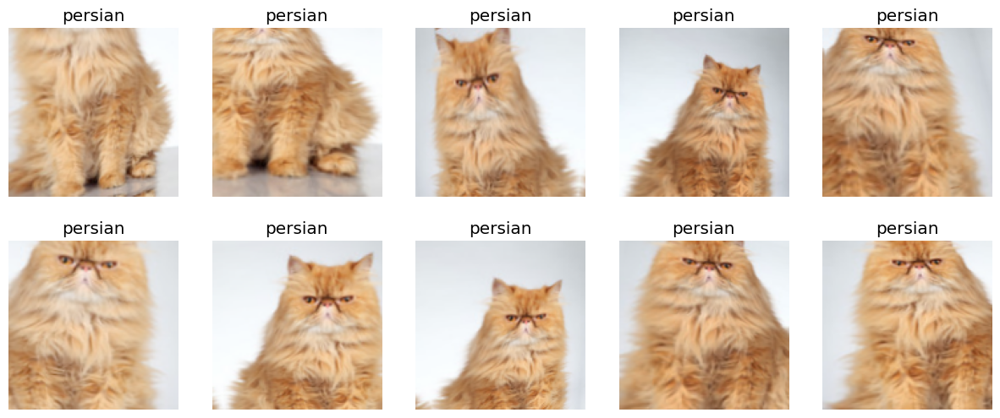

In [ ]:
cats = cats.new(item_tfms=RandomResizedCrop(128, min_scale=0.3), batch_tfms=aug_transforms())
dls = cats.dataloaders(path)
dls.train.show_batch(max_n=10, nrows=2, unique=True)

learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(5)

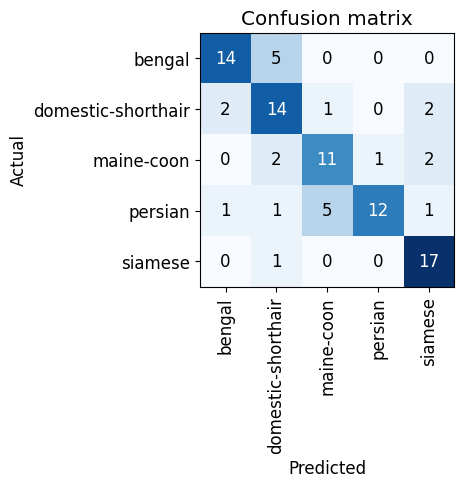

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [ ]:
learn.export()